# Data Analysis & Visualization Project: Obesity DataSet

## Group Member: Li, Peifeng \ Wang, Conghao

Our project is mainly focus on the obesity issue in the world. We will analyze the topic by exploring 2 dataset - one is the share of death related to obesity across the world, another dataset we will dive deep to figure out the key effects that may lead to obesity.

We hope we can tell a story and educate people to obtain a healthier lifestyle to prevent obesity.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
import warnings
warnings.simplefilter("ignore")

from pandas.api.types import is_string_dtype, is_numeric_dtype
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.manifold import MDS, TSNE

## 1. Share of Death Related to Obesity  

This data set is going to claim the trend of share of death related to obesity in the world, which is also a reminder to people that obesity is not very far from our daily life. 

The data set contains the country's share of death related to obesity from 1990 to 2017, the data set information as follows:\
Entity: Country name\
CODE: Country code\
Year: From 1990 to 2017\
Obesity(IHME, 2019): Share of death related to obesity in the total death, Numerical (0, 1)

The data set could also be found [here](https://ourworldindata.org/grapher/share-of-deaths-obesity?tab=chart&time=1990..latest) 

In [2]:
ob = pd.read_csv('/Users/bryton/Desktop/ObesityDataSet/share-of-deaths-obesity.csv')
ob.shape

(5432, 4)

In [3]:
ob.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5432 entries, 0 to 5431
Data columns (total 4 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Entity                5432 non-null   object 
 1   Code                  5432 non-null   object 
 2   Year                  5432 non-null   int64  
 3   Obesity (IHME, 2019)  5432 non-null   float64
dtypes: float64(1), int64(1), object(2)
memory usage: 169.9+ KB


In [4]:
ob.head()

,Entity,Code,Year,"Obesity (IHME, 2019)"
0,Afghanistan,AFG,1990,3.92
1,Afghanistan,AFG,1991,3.87
2,Afghanistan,AFG,1992,3.82
3,Afghanistan,AFG,1993,3.50
4,Afghanistan,AFG,1994,3.25


In [5]:
ob.describe()

,Year,"Obesity (IHME, 2019)"
count,5432.000000,5432.000000
mean,2003.500000,9.024901
std,8.078491,5.466846
min,1990.000000,0.150000
25%,1996.750000,3.990000
50%,2003.500000,9.220000
75%,2010.250000,13.082500
max,2017.000000,29.430000


<AxesSubplot:xlabel='Year', ylabel='Obesity (IHME, 2019)'>

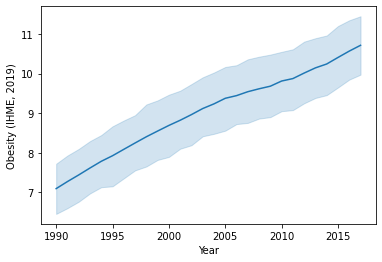

In [6]:
sns.lineplot(data = ob, x = 'Year', y = 'Obesity (IHME, 2019)')

<AxesSubplot:xlabel='Obesity (IHME, 2019)', ylabel='Count'>

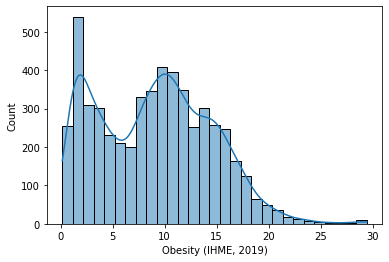

In [7]:
sns.histplot(data = ob, x = 'Obesity (IHME, 2019)', kde = True)

<AxesSubplot:xlabel='Obesity (IHME, 2019)'>

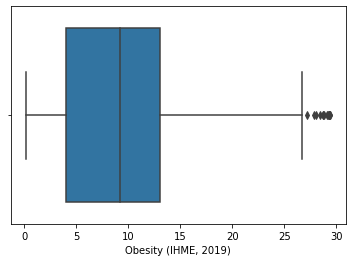

In [8]:
sns.boxplot(data = ob, x = 'Obesity (IHME, 2019)')

## 2. Obesity Dataset 

The Obesity dataset contains data for the estimation of obesity levels in individuals from the countries of Mexico, Peru and Colombia, based on their eating habits and physical condition. 

Dataset information:\
The attributes of basic information:\
Gender: Categorical ('Male' , 'Female')\
Age: Numerical\
Height: Numerical\
Weight: Numerical\
family_history_with_overweight: Categorical ('Yes', 'No')

The attributes related with eating habits:\
FAVC: Frequent consumption of high caloric food, Categorical ('Yes', 'No')\
FCVC: Frequency of consumption of vegetables, Categorical ('Yes', 'No')\
NCP: Number of main meals, Numerical\
SMOKE: Categorical ('Yes' , 'No')\
CAEC: Consumption of food between meals, Categorical ('Sometimes', 'Frequently', 'Always', 'No')\
CH20: Consumption of water daily, Numerical\
CALC: Consumption of alcohol, Categorical ('No', 'Sometimes', 'Frequently', 'Always')

The attributes related with the physical conditions: \
SCC: Calories consumption monitoring, Categorical ('No', 'Yes')\
FAF: Physical activity frequency, Numerical\
TUE: Time using technology devices, Numerical\
MTRANS: Transportation used, Categorical ('Public_Transportation', 'Walking', 'Automobile', 'Motorbike', 'Bike')

Target:\
NObesity: Categorical ('Insufficient Weight', 'Normal Weight', 'Overweight Level I', 'Overweight Level II', 'Obesity Type I', 'Obesity Type II', 'Obesity Type III')

The data set could be found [here](https://www.sciencedirect.com/science/article/pii/S2352340919306985?via%3Dihub)

### Data Inspection

In [9]:
# import our Obesity data set
df = pd.read_csv('/Users/bryton/Desktop/ObesityDataSet/ObesityDataSet.csv')
df.shape

(2111, 17)

In [10]:
# make sure there are no null values in the data set
df.isnull().sum()

Gender                            0
Age                               0
Height                            0
Weight                            0
family_history_with_overweight    0
FAVC                              0
FCVC                              0
NCP                               0
CAEC                              0
SMOKE                             0
CH2O                              0
SCC                               0
FAF                               0
TUE                               0
CALC                              0
MTRANS                            0
NObeyesdad                        0
dtype: int64

In [11]:
# matadata of the data set
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2111 entries, 0 to 2110
Data columns (total 17 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Gender                          2111 non-null   object 
 1   Age                             2111 non-null   float64
 2   Height                          2111 non-null   float64
 3   Weight                          2111 non-null   float64
 4   family_history_with_overweight  2111 non-null   object 
 5   FAVC                            2111 non-null   object 
 6   FCVC                            2111 non-null   float64
 7   NCP                             2111 non-null   float64
 8   CAEC                            2111 non-null   object 
 9   SMOKE                           2111 non-null   object 
 10  CH2O                            2111 non-null   float64
 11  SCC                             2111 non-null   object 
 12  FAF                             21

There are 9 categorical values in the data set. We have to investigate these value and do feature engineering later on.

In [12]:
# simple stastics
df.describe(include = 'all')

,Gender,Age,Height,Weight,family_history_with_overweight,FAVC,FCVC,NCP,CAEC,SMOKE,CH2O,SCC,FAF,TUE,CALC,MTRANS,NObeyesdad
count,2111,2111.000000,2111.000000,2111.000000,2111,2111,2111.000000,2111.000000,2111,2111,2111.000000,2111,2111.000000,2111.000000,2111,2111,2111
unique,2,NaN,NaN,NaN,2,2,NaN,NaN,4,2,NaN,2,NaN,NaN,4,5,7
top,Male,NaN,NaN,NaN,yes,yes,NaN,NaN,Sometimes,no,NaN,no,NaN,NaN,Sometimes,Public_Transportation,Obesity_Type_I
freq,1068,NaN,NaN,NaN,1726,1866,NaN,NaN,1765,2067,NaN,2015,NaN,NaN,1401,1580,351
mean,NaN,24.312600,1.701677,86.586058,NaN,NaN,2.419043,2.685628,NaN,NaN,2.008011,NaN,1.010298,0.657866,NaN,NaN,NaN
std,NaN,6.345968,0.093305,26.191172,NaN,NaN,0.533927,0.778039,NaN,NaN,0.612953,NaN,0.850592,0.608927,NaN,NaN,NaN
min,NaN,14.000000,1.450000,39.000000,NaN,NaN,1.000000,1.000000,NaN,NaN,1.000000,NaN,0.000000,0.000000,NaN,NaN,NaN
25%,NaN,19.947192,1.630000,65.473343,NaN,NaN,2.000000,2.658738,NaN,NaN,1.584812,NaN,0.124505,0.000000,NaN,NaN,NaN
50%,NaN,22.777890,1.700499,83.000000,NaN,NaN,2.385502,3.000000,NaN,NaN,2.000000,NaN,1.000000,0.625350,NaN,NaN,NaN
75%,NaN,26.000000,1.768464,107.430682,NaN,NaN,3.000000,3.000000,NaN,NaN,2.477420,NaN,1.666678,1.000000,NaN,NaN,NaN


#### Investigate unique categorical values

In [13]:
df.Gender.unique()

array(['Female', 'Male'], dtype=object)

In [14]:
df.family_history_with_overweight.unique()

array(['yes', 'no'], dtype=object)

In [15]:
df.FAVC.unique()

array(['no', 'yes'], dtype=object)

In [16]:
df.CAEC.unique()

array(['Sometimes', 'Frequently', 'Always', 'no'], dtype=object)

In [17]:
df.SMOKE.unique()

array(['no', 'yes'], dtype=object)

In [18]:
df.SCC.unique()

array(['no', 'yes'], dtype=object)

In [19]:
df.CALC.unique()

array(['no', 'Sometimes', 'Frequently', 'Always'], dtype=object)

In [20]:
df.MTRANS.unique()

array(['Public_Transportation', 'Walking', 'Automobile', 'Motorbike',
       'Bike'], dtype=object)

In [21]:
df.NObeyesdad.unique()

array(['Normal_Weight', 'Overweight_Level_I', 'Overweight_Level_II',
       'Obesity_Type_I', 'Insufficient_Weight', 'Obesity_Type_II',
       'Obesity_Type_III'], dtype=object)

### EDA - Univariate Analysis

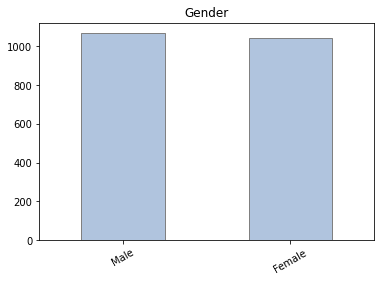

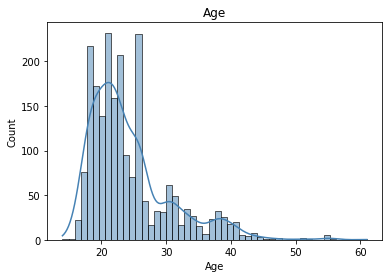

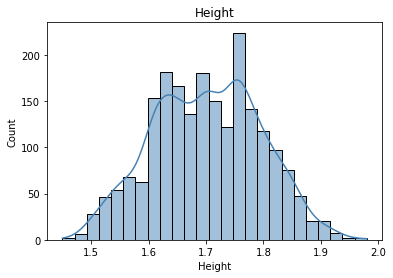

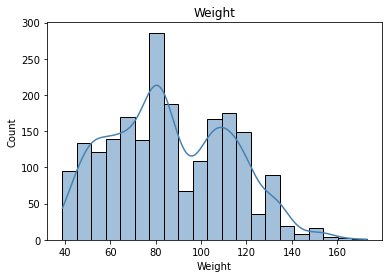

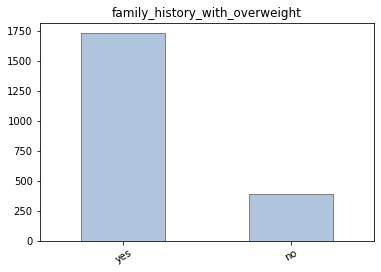

...

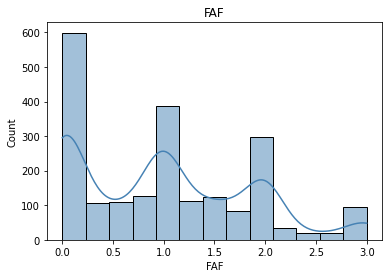

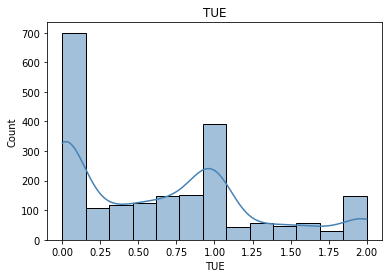

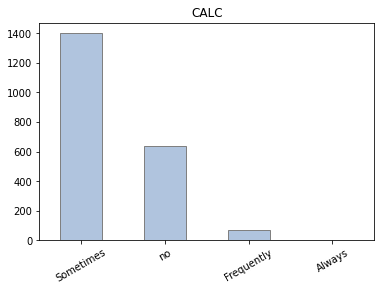

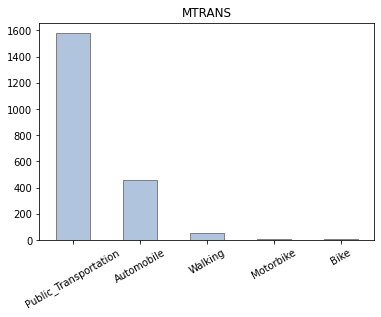

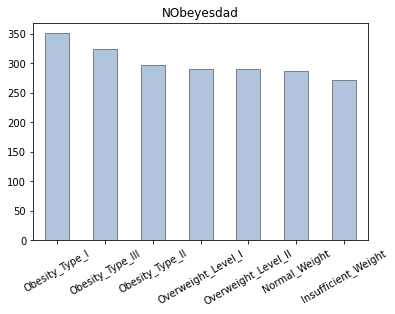

In [22]:
for column in df:
    plt.figure(column)
    plt.title(column)
    if is_numeric_dtype(df[column]):
        #df[column].plot(kind = 'hist')
        sns.histplot(df[column], kde = True, color = 'steelblue')
    elif is_string_dtype(df[column]):
        df[column].value_counts().plot(kind = 'bar', color = 'lightsteelblue', edgecolor = 'gray')
        plt.xticks(rotation = 30)

### EDA - Multivariate Analysis

In [23]:
# divide the data set into categorical and numerical subsets
# categorical list
cat = df[['Gender', 'family_history_with_overweight', 'FAVC', 'CAEC', 'SMOKE', 'SCC', 
              'CALC', 'MTRANS', 'NObeyesdad']]
cat

,Gender,family_history_with_overweight,FAVC,CAEC,SMOKE,SCC,CALC,MTRANS,NObeyesdad
0,Female,yes,no,Sometimes,no,no,no,Public_Transportation,Normal_Weight
1,Female,yes,no,Sometimes,yes,yes,Sometimes,Public_Transportation,Normal_Weight
2,Male,yes,no,Sometimes,no,no,Frequently,Public_Transportation,Normal_Weight
3,Male,no,no,Sometimes,no,no,Frequently,Walking,Overweight_Level_I
4,Male,no,no,Sometimes,no,no,Sometimes,Public_Transportation,Overweight_Level_II
...,...,...,...,...,...,...,...,...,...
2106,Female,yes,yes,Sometimes,no,no,Sometimes,Public_Transportation,Obesity_Type_III
2107,Female,yes,yes,Sometimes,no,no,Sometimes,Public_Transportation,Obesity_Type_III
2108,Female,yes,yes,Sometimes,no,no,Sometimes,Public_Transportation,Obesity_Type_III
2109,Female,yes,yes,Sometimes,no,no,Sometimes,Public_Transportation,Obesity_Type_III


In [24]:
# Numerical list
num = df[['Age', 'Height', 'Weight', 'FCVC', 'NCP', 'CH2O', 'FAF', 'TUE']]
num

,Age,Height,Weight,FCVC,NCP,CH2O,FAF,TUE
0,21.000000,1.620000,64.000000,2.0,3.0,2.000000,0.000000,1.000000
1,21.000000,1.520000,56.000000,3.0,3.0,3.000000,3.000000,0.000000
2,23.000000,1.800000,77.000000,2.0,3.0,2.000000,2.000000,1.000000
3,27.000000,1.800000,87.000000,3.0,3.0,2.000000,2.000000,0.000000
4,22.000000,1.780000,89.800000,2.0,1.0,2.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...
2106,20.976842,1.710730,131.408528,3.0,3.0,1.728139,1.676269,0.906247
2107,21.982942,1.748584,133.742943,3.0,3.0,2.005130,1.341390,0.599270
2108,22.524036,1.752206,133.689352,3.0,3.0,2.054193,1.414209,0.646288
2109,24.361936,1.739450,133.346641,3.0,3.0,2.852339,1.139107,0.586035


In [25]:
cat_list = []
num_list = []

for column in df:
    if is_numeric_dtype(df[column]):
        num_list.append(column)
    elif is_string_dtype(df[column]):
        cat_list.append(column)

print(cat_list)
print(num_list)

['Gender', 'family_history_with_overweight', 'FAVC', 'CAEC', 'SMOKE', 'SCC', 'CALC', 'MTRANS', 'NObeyesdad']
['Age', 'Height', 'Weight', 'FCVC', 'NCP', 'CH2O', 'FAF', 'TUE']


###  Numerical v.s. Numerical Variables

#### Heat map

(array([0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5, 7.5]),
 [Text(0.5, 0, 'Age'),
  Text(1.5, 0, 'Height'),
  Text(2.5, 0, 'Weight'),
  Text(3.5, 0, 'FCVC'),
  Text(4.5, 0, 'NCP'),
  Text(5.5, 0, 'CH2O'),
  Text(6.5, 0, 'FAF'),
  Text(7.5, 0, 'TUE')])

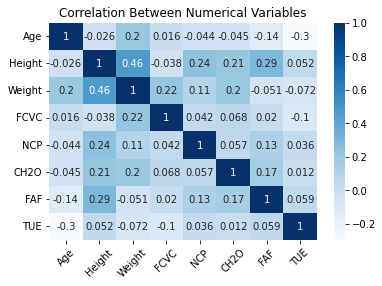

In [26]:
# correlation matrix and the heatmap
correlation = df.corr()
sns.heatmap(correlation, cmap = 'Blues', annot = True)
plt.title('Correlation Between Numerical Variables')
plt.xticks(rotation = 45)

#### Pair plots

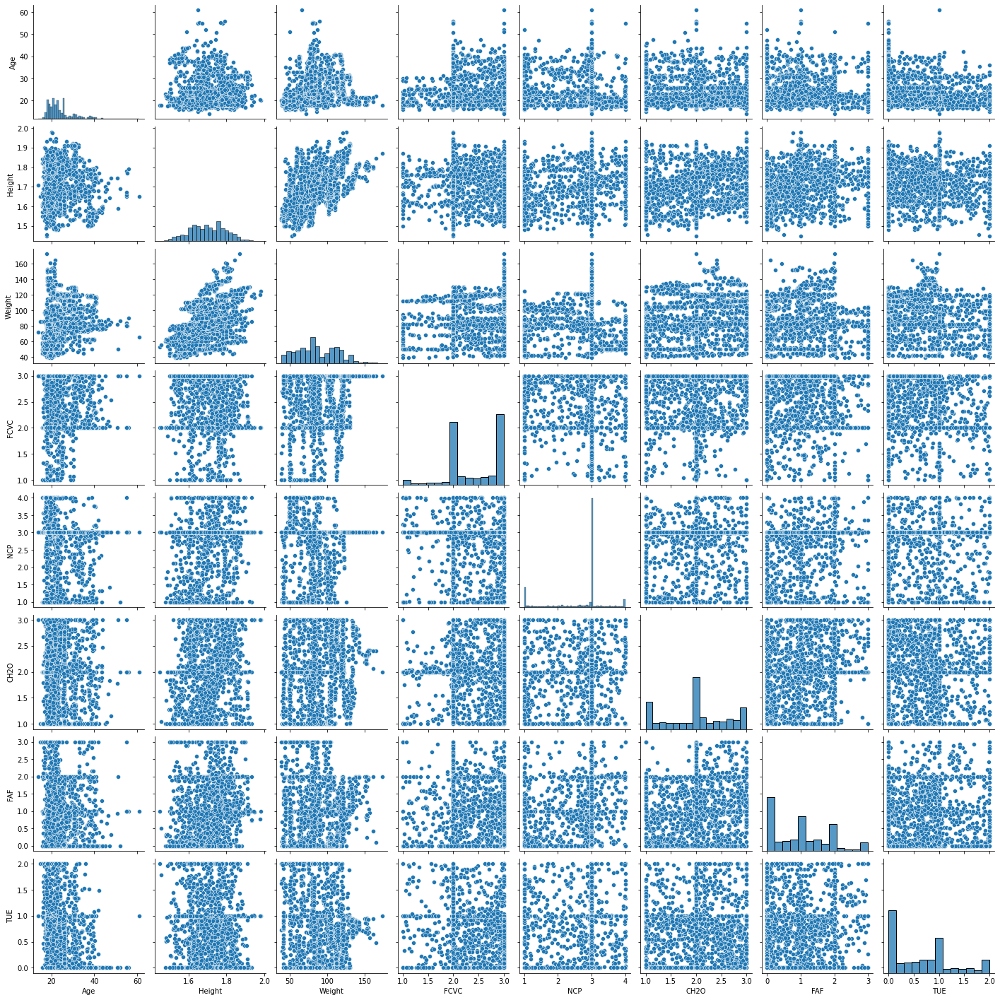

In [27]:
sns.pairplot(num, height = 2.5)

###  Categorical v.s. Numerical Variables

#### Box plots

In [28]:
fig, axes = plt.subplots(9, 8, figsize=(180, 160))

for i in range(0, len(cat_list)):
    cat = cat_list[i]
    for j in range(0, len(num_list)):
        num = num_list[j]
        sns.boxplot(ax = axes[i, j], x = cat, y = num,
                       data= df, palette = 'Blues')

#### Pair plots

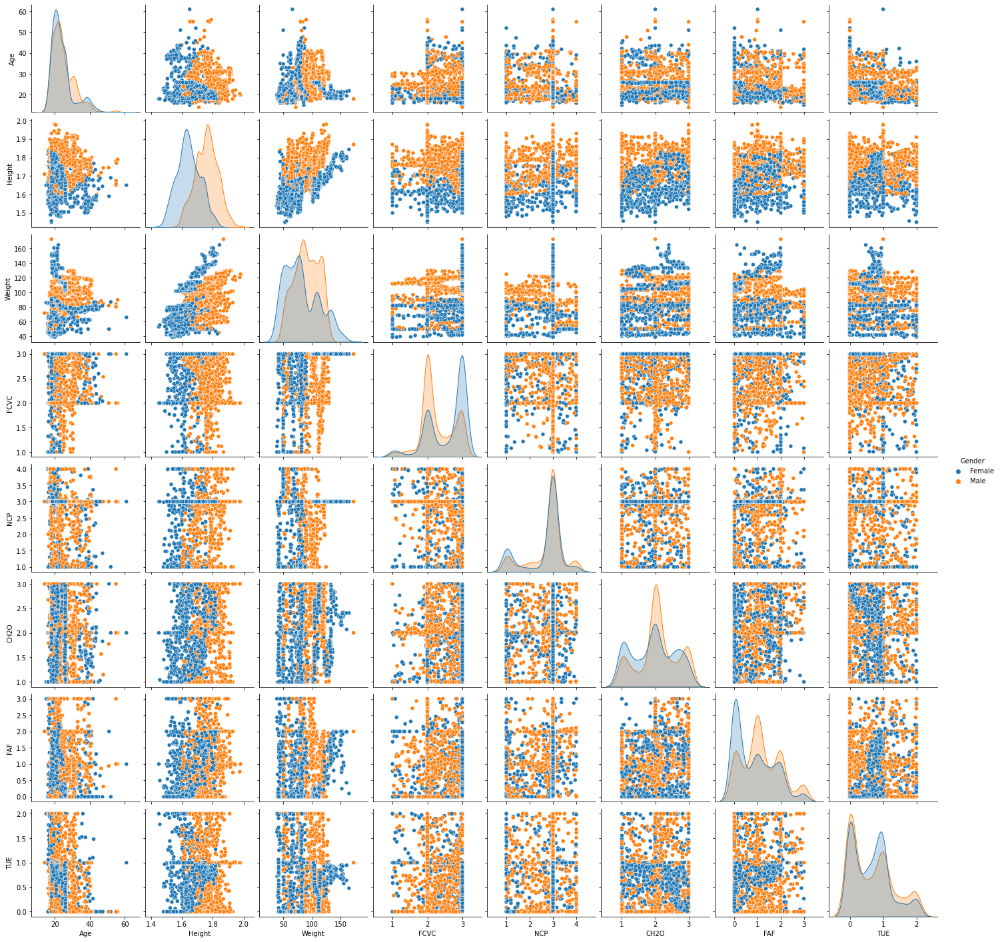

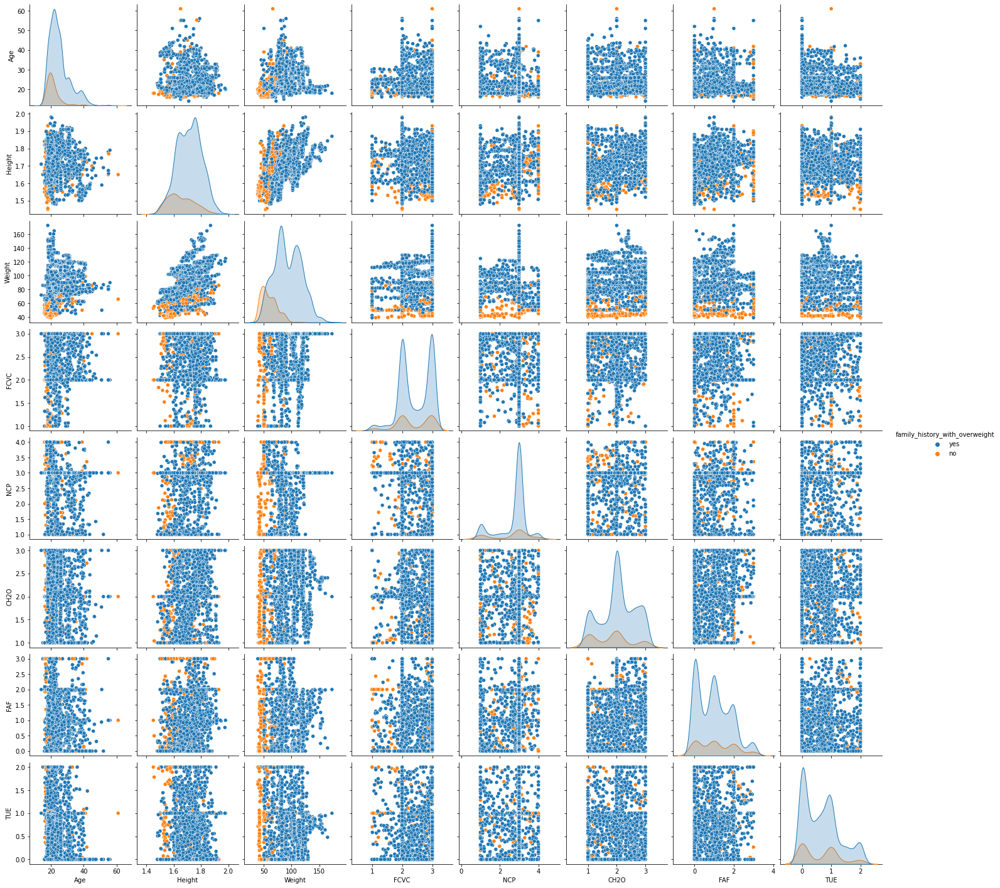

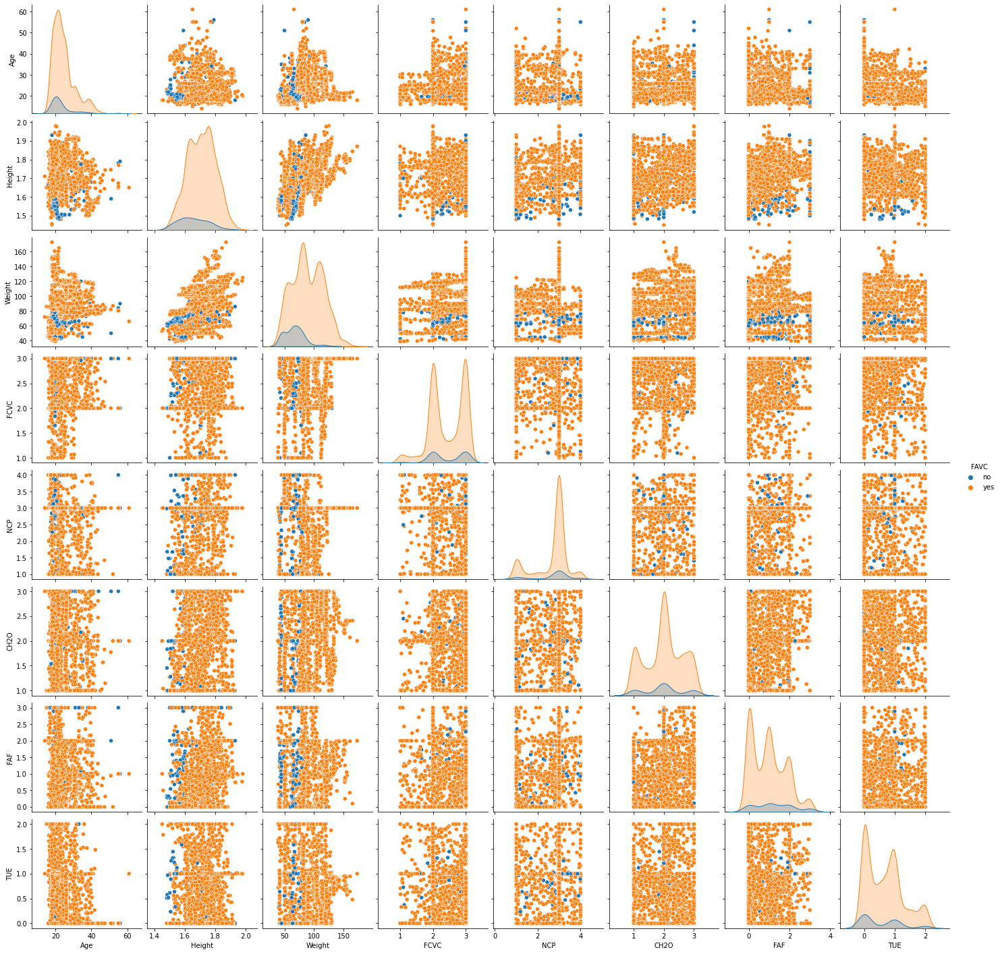

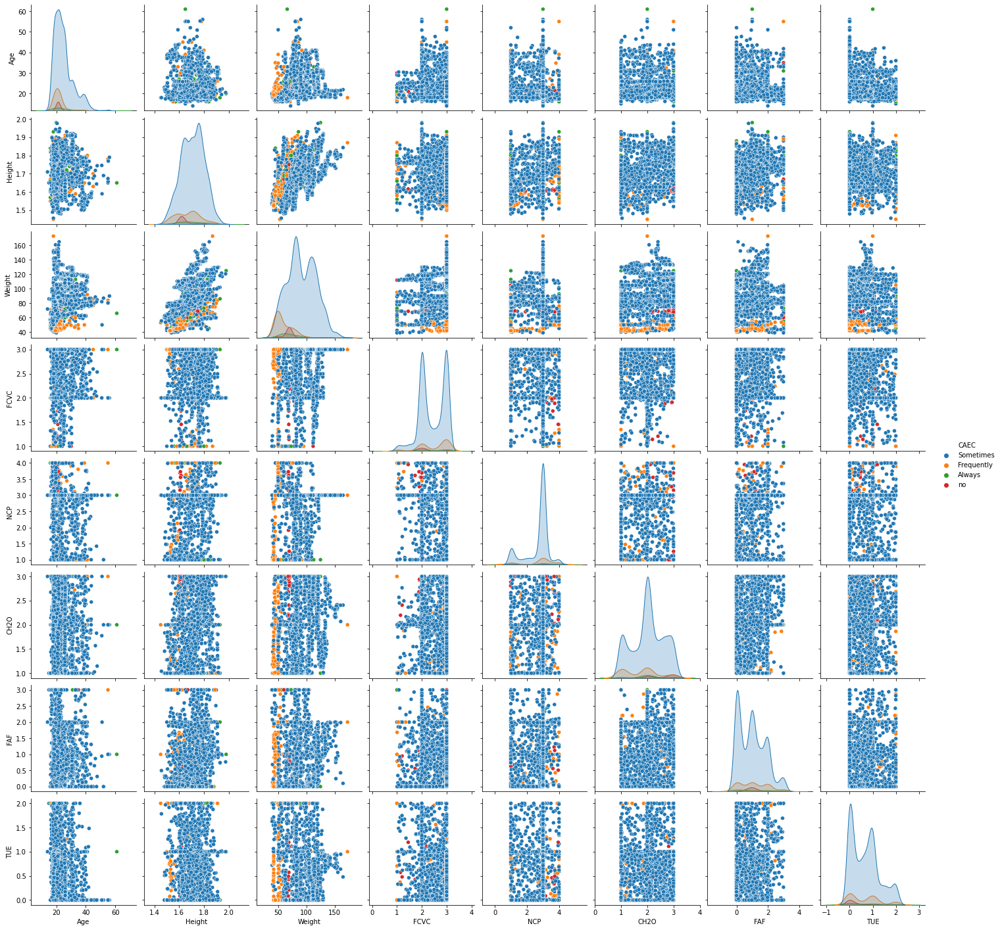

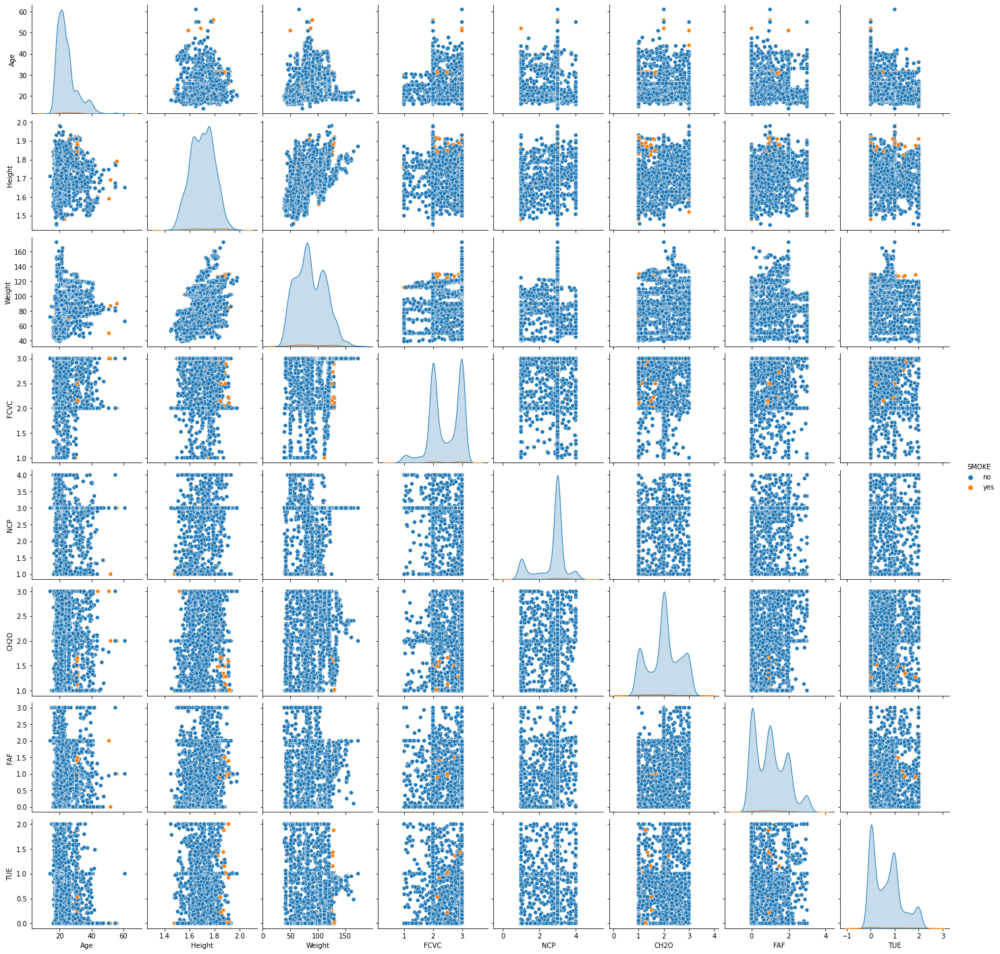

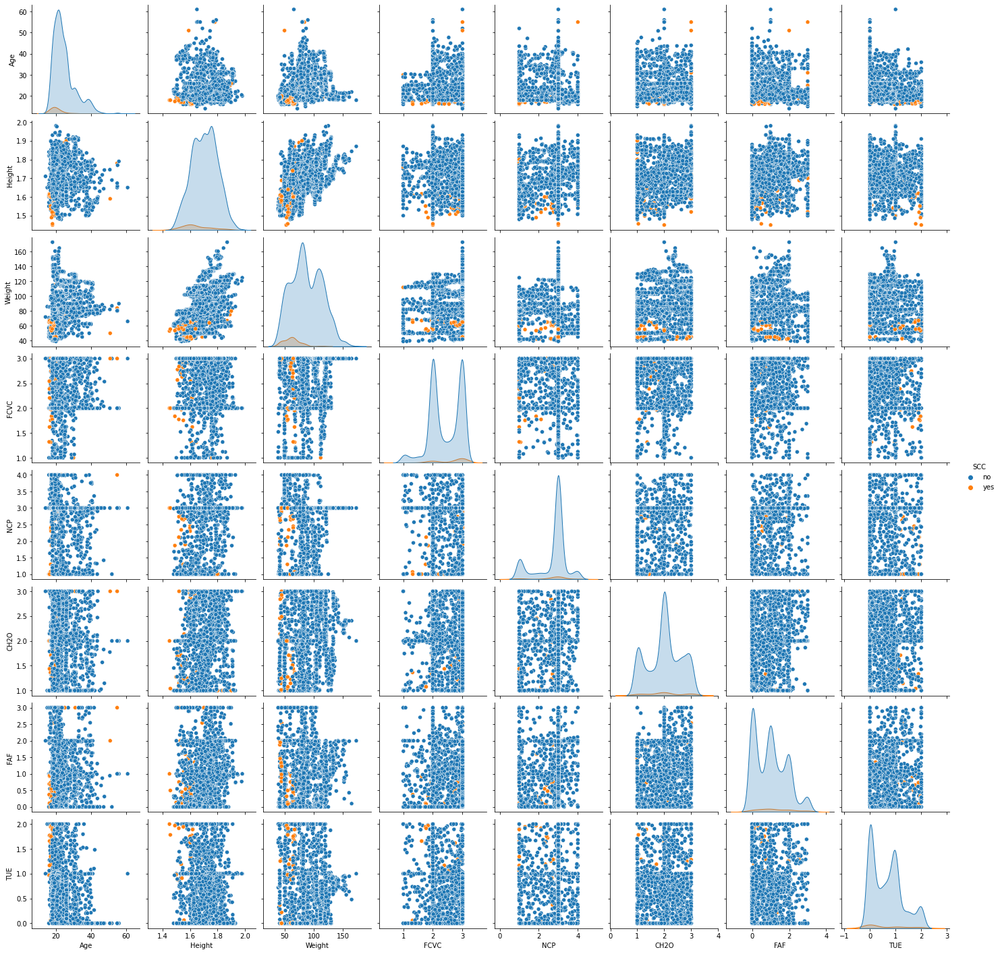

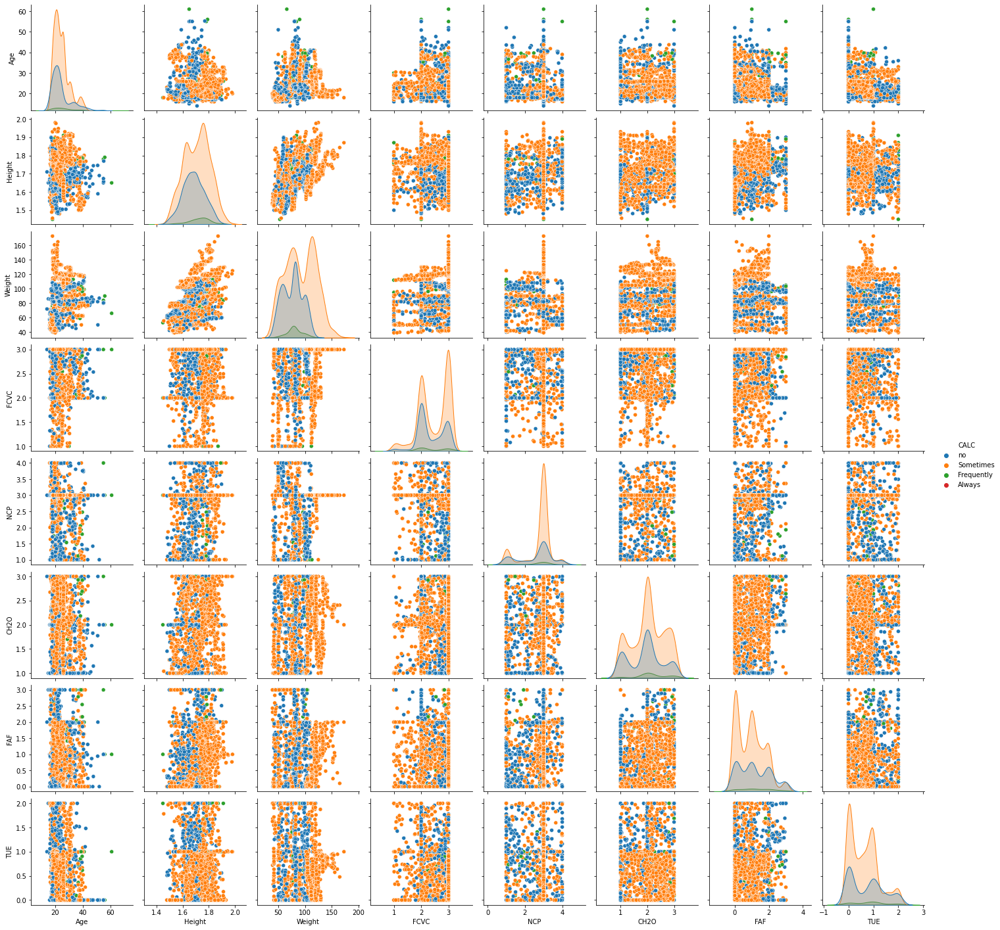

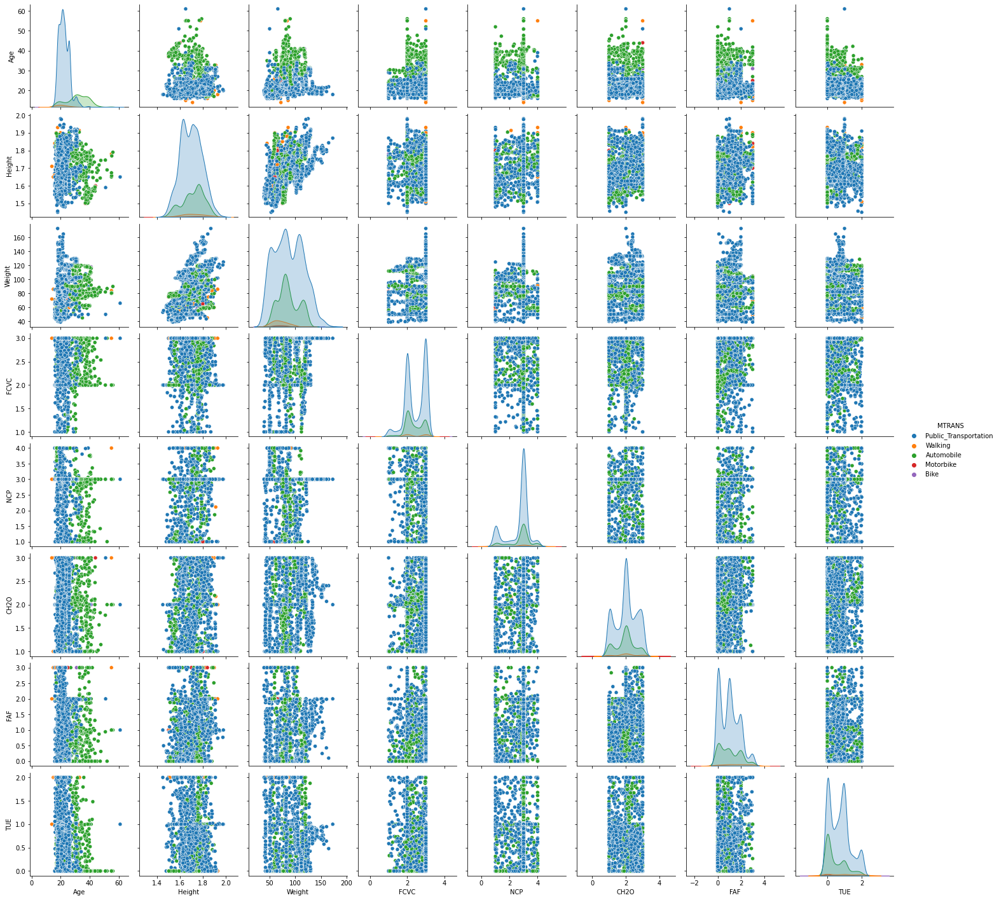

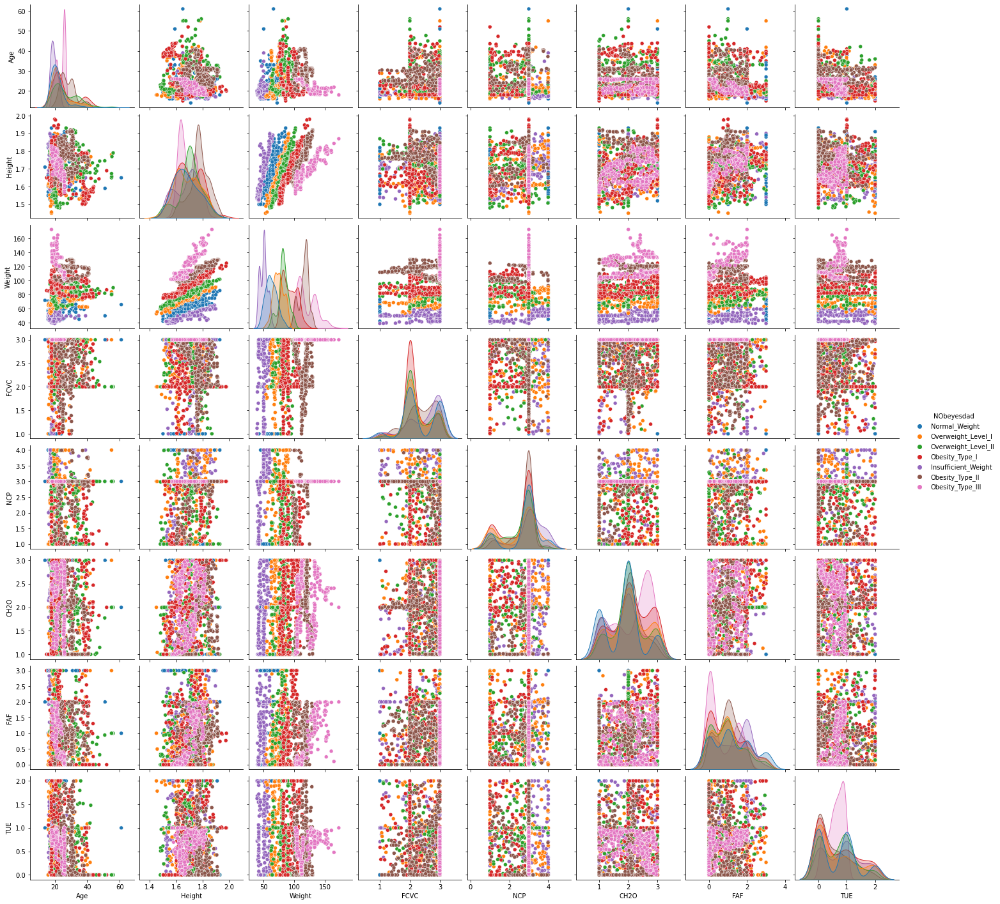

In [29]:
for i in range(0, len(cat_list)):
    hue_cat = cat_list[i]
    sns.pairplot(df, hue = hue_cat)

### Data Preparations

In [30]:
# transform categorical variables into dummie variables
dummies = pd.DataFrame(pd.get_dummies(df[["Gender", "family_history_with_overweight", "FAVC", "CAEC", "SMOKE", "SCC", "CALC", "MTRANS"]]))

dummies

,Gender_Female,Gender_Male,family_history_with_overweight_no,family_history_with_overweight_yes,FAVC_no,FAVC_yes,CAEC_Always,CAEC_Frequently,CAEC_Sometimes,CAEC_no,...,SCC_yes,CALC_Always,CALC_Frequently,CALC_Sometimes,CALC_no,MTRANS_Automobile,MTRANS_Bike,MTRANS_Motorbike,MTRANS_Public_Transportation,MTRANS_Walking
0,1,0,0,1,1,0,0,0,1,0,...,0,0,0,0,1,0,0,0,1,0
1,1,0,0,1,1,0,0,0,1,0,...,1,0,0,1,0,0,0,0,1,0
2,0,1,0,1,1,0,0,0,1,0,...,0,0,1,0,0,0,0,0,1,0
3,0,1,1,0,1,0,0,0,1,0,...,0,0,1,0,0,0,0,0,0,1
4,0,1,1,0,1,0,0,0,1,0,...,0,0,0,1,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2106,1,0,0,1,0,1,0,0,1,0,...,0,0,0,1,0,0,0,0,1,0
2107,1,0,0,1,0,1,0,0,1,0,...,0,0,0,1,0,0,0,0,1,0
2108,1,0,0,1,0,1,0,0,1,0,...,0,0,0,1,0,0,0,0,1,0
2109,1,0,0,1,0,1,0,0,1,0,...,0,0,0,1,0,0,0,0,1,0


In [31]:
ob_target = df[['Age', 'Height', 'Weight', 'FCVC', 'NCP', 'CH2O', 'FAF', 'TUE','NObeyesdad']]
ob_target

,Age,Height,Weight,FCVC,NCP,CH2O,FAF,TUE,NObeyesdad
0,21.000000,1.620000,64.000000,2.0,3.0,2.000000,0.000000,1.000000,Normal_Weight
1,21.000000,1.520000,56.000000,3.0,3.0,3.000000,3.000000,0.000000,Normal_Weight
2,23.000000,1.800000,77.000000,2.0,3.0,2.000000,2.000000,1.000000,Normal_Weight
3,27.000000,1.800000,87.000000,3.0,3.0,2.000000,2.000000,0.000000,Overweight_Level_I
4,22.000000,1.780000,89.800000,2.0,1.0,2.000000,0.000000,0.000000,Overweight_Level_II
...,...,...,...,...,...,...,...,...,...
2106,20.976842,1.710730,131.408528,3.0,3.0,1.728139,1.676269,0.906247,Obesity_Type_III
2107,21.982942,1.748584,133.742943,3.0,3.0,2.005130,1.341390,0.599270,Obesity_Type_III
2108,22.524036,1.752206,133.689352,3.0,3.0,2.054193,1.414209,0.646288,Obesity_Type_III
2109,24.361936,1.739450,133.346641,3.0,3.0,2.852339,1.139107,0.586035,Obesity_Type_III


In [32]:
ob_c = pd.concat([dummies, ob_target], axis = 1)
ob_c

,Gender_Female,Gender_Male,family_history_with_overweight_no,family_history_with_overweight_yes,FAVC_no,FAVC_yes,CAEC_Always,CAEC_Frequently,CAEC_Sometimes,CAEC_no,...,MTRANS_Walking,Age,Height,Weight,FCVC,NCP,CH2O,FAF,TUE,NObeyesdad
0,1,0,0,1,1,0,0,0,1,0,...,0,21.000000,1.620000,64.000000,2.0,3.0,2.000000,0.000000,1.000000,Normal_Weight
1,1,0,0,1,1,0,0,0,1,0,...,0,21.000000,1.520000,56.000000,3.0,3.0,3.000000,3.000000,0.000000,Normal_Weight
2,0,1,0,1,1,0,0,0,1,0,...,0,23.000000,1.800000,77.000000,2.0,3.0,2.000000,2.000000,1.000000,Normal_Weight
3,0,1,1,0,1,0,0,0,1,0,...,1,27.000000,1.800000,87.000000,3.0,3.0,2.000000,2.000000,0.000000,Overweight_Level_I
4,0,1,1,0,1,0,0,0,1,0,...,0,22.000000,1.780000,89.800000,2.0,1.0,2.000000,0.000000,0.000000,Overweight_Level_II
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2106,1,0,0,1,0,1,0,0,1,0,...,0,20.976842,1.710730,131.408528,3.0,3.0,1.728139,1.676269,0.906247,Obesity_Type_III
2107,1,0,0,1,0,1,0,0,1,0,...,0,21.982942,1.748584,133.742943,3.0,3.0,2.005130,1.341390,0.599270,Obesity_Type_III
2108,1,0,0,1,0,1,0,0,1,0,...,0,22.524036,1.752206,133.689352,3.0,3.0,2.054193,1.414209,0.646288,Obesity_Type_III
2109,1,0,0,1,0,1,0,0,1,0,...,0,24.361936,1.739450,133.346641,3.0,3.0,2.852339,1.139107,0.586035,Obesity_Type_III


In [34]:
# Split train and test
X = ob_c.drop(columns = ["NObeyesdad"])

y = df[['NObeyesdad']]

In [35]:
X

,Gender_Female,Gender_Male,family_history_with_overweight_no,family_history_with_overweight_yes,FAVC_no,FAVC_yes,CAEC_Always,CAEC_Frequently,CAEC_Sometimes,CAEC_no,...,MTRANS_Public_Transportation,MTRANS_Walking,Age,Height,Weight,FCVC,NCP,CH2O,FAF,TUE
0,1,0,0,1,1,0,0,0,1,0,...,1,0,21.000000,1.620000,64.000000,2.0,3.0,2.000000,0.000000,1.000000
1,1,0,0,1,1,0,0,0,1,0,...,1,0,21.000000,1.520000,56.000000,3.0,3.0,3.000000,3.000000,0.000000
2,0,1,0,1,1,0,0,0,1,0,...,1,0,23.000000,1.800000,77.000000,2.0,3.0,2.000000,2.000000,1.000000
3,0,1,1,0,1,0,0,0,1,0,...,0,1,27.000000,1.800000,87.000000,3.0,3.0,2.000000,2.000000,0.000000
4,0,1,1,0,1,0,0,0,1,0,...,1,0,22.000000,1.780000,89.800000,2.0,1.0,2.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2106,1,0,0,1,0,1,0,0,1,0,...,1,0,20.976842,1.710730,131.408528,3.0,3.0,1.728139,1.676269,0.906247
2107,1,0,0,1,0,1,0,0,1,0,...,1,0,21.982942,1.748584,133.742943,3.0,3.0,2.005130,1.341390,0.599270
2108,1,0,0,1,0,1,0,0,1,0,...,1,0,22.524036,1.752206,133.689352,3.0,3.0,2.054193,1.414209,0.646288
2109,1,0,0,1,0,1,0,0,1,0,...,1,0,24.361936,1.739450,133.346641,3.0,3.0,2.852339,1.139107,0.586035


In [36]:
y

,NObeyesdad
0,Normal_Weight
1,Normal_Weight
2,Normal_Weight
3,Overweight_Level_I
4,Overweight_Level_II
...,...
2106,Obesity_Type_III
2107,Obesity_Type_III
2108,Obesity_Type_III
2109,Obesity_Type_III


### Decision Tree & Random Forest

In [37]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=0)

In [43]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
from sklearn.preprocessing import MinMaxScaler 

In [46]:
# standard scale data
ss = StandardScaler()
X_train_scaled = ss.fit_transform(X_train)
X_test_scaled = ss.transform(X_test)

# program to run multilple models though sklearn 
# Default settings output accuracy and classification report
# compares accuracy for scaled and unscaled data
def run_models(X_train: pd.DataFrame , y_train: pd.DataFrame, X_test: pd.DataFrame, y_test: pd.DataFrame):
    
    models = [          
          ('Random Forest', RandomForestClassifier(random_state=0)),
          ('Decision Tree', DecisionTreeClassifier()),                                                 
        ]  
    
    for name, model in models:        
        # unscaled data
        clf = model.fit(X_train, y_train)
        y_pred = clf.predict(X_test)
        
        # scaled data
        clf_scaled = model.fit(X_train_scaled, y_train)
        y_pred_scaled = clf_scaled.predict(X_test_scaled)
        
        # accuracy scores
        accuracy = round(metrics.accuracy_score(y_test, y_pred),5)
        scaled_accuracy = round(metrics.accuracy_score(y_test, y_pred_scaled),5)
        
        # output
        print(name + ':')        
        print("---------------------------------------------------------------")      
        print("Accuracy:", accuracy)
        print("Accuracy w/Scaled Data (ss):", scaled_accuracy)  
        print("\nClassification Report (ss):\n", metrics.classification_report(y_test, y_pred_scaled))  

In [47]:
#run Decision Trees, Random Forest, KNN and SVM
run_models(X_train, y_train, X_test, y_test)

Random Forest:
---------------------------------------------------------------
Accuracy: 0.9375
Accuracy w/Scaled Data (ss): 0.9375

Classification Report (ss):
                      precision    recall  f1-score   support

Insufficient_Weight       1.00      0.92      0.96        78
      Normal_Weight       0.73      0.99      0.84        69
     Obesity_Type_I       0.99      0.94      0.96        86
    Obesity_Type_II       1.00      1.00      1.00        73
   Obesity_Type_III       1.00      1.00      1.00        88
 Overweight_Level_I       0.93      0.81      0.87        68
Overweight_Level_II       0.95      0.88      0.91        66

           accuracy                           0.94       528
          macro avg       0.94      0.93      0.93       528
       weighted avg       0.95      0.94      0.94       528

Decision Tree:
---------------------------------------------------------------
Accuracy: 0.92235
Accuracy w/Scaled Data (ss): 0.92803

Classification Report (ss):
 

### Hyperparameter Tuning

In [50]:
from sklearn.model_selection import GridSearchCV

#model name, classifier, parameters
# function used to process models and parameters through gridsearch
def hyper_tune(name, clf, parameters, target_names=None): 
    
    target_names = target_names
    clf = clf
    search = GridSearchCV(clf, parameters,verbose=True, n_jobs=15, cv=5)
    search.fit(X_train_scaled,y_train)
    y_pred_scaled = search.predict(X_test_scaled)
    print ("Accuracy Score = %3.2f" %(search.score(X_test_scaled,y_test)))
    print (search.best_params_)
    print("\nClassification Report:\n", metrics.classification_report(y_test, y_pred_scaled, target_names=target_names))

In [51]:
# Number of trees in random forest
n_estimators = [int(x) for x in range(10, 200,10)]
# Criterion
criterion = ['gini','entropy']
# Number of features to consider at every split
max_features = ['auto', 'sqrt', 'log2']
# Maximum number of levels in tree
max_depth = [int(x) for x in range(10, 100, 10)]
max_depth.append(None)
# Minimum number of samples required to split a node
min_samples_split = [int(x) for x in range(2, 5)]
# Minimum number of samples required at each leaf node
min_samples_leaf = [int(x) for x in range(2, 5)]
# Method of selecting samples for training each tree
bootstrap = [True, False]
# random state
random_state = [0]

parameters = { 'criterion':criterion,
               'n_estimators': n_estimators,
              'max_depth':max_depth,
              'random_state': random_state,
              'max_features':max_features,
              'min_samples_split':min_samples_split             
               }


hyper_tune('Random Forest',
           RandomForestClassifier(), parameters)

Fitting 5 folds for each of 3420 candidates, totalling 17100 fits


[Parallel(n_jobs=15)]: Using backend LokyBackend with 15 concurrent workers.
[Parallel(n_jobs=15)]: Done  20 tasks      | elapsed:    2.9s
[Parallel(n_jobs=15)]: Done 170 tasks      | elapsed:    9.3s
[Parallel(n_jobs=15)]: Done 420 tasks      | elapsed:   19.2s
[Parallel(n_jobs=15)]: Done 770 tasks      | elapsed:   33.7s
[Parallel(n_jobs=15)]: Done 1220 tasks      | elapsed:   53.6s
[Parallel(n_jobs=15)]: Done 1770 tasks      | elapsed:  1.3min
[Parallel(n_jobs=15)]: Done 2420 tasks      | elapsed:  1.8min
[Parallel(n_jobs=15)]: Done 3170 tasks      | elapsed:  2.3min
[Parallel(n_jobs=15)]: Done 4020 tasks      | elapsed:  2.9min
[Parallel(n_jobs=15)]: Done 4970 tasks      | elapsed:  3.6min
[Parallel(n_jobs=15)]: Done 6020 tasks      | elapsed:  4.4min
[Parallel(n_jobs=15)]: Done 7170 tasks      | elapsed:  5.3min
[Parallel(n_jobs=15)]: Done 8420 tasks      | elapsed:  6.2min
[Parallel(n_jobs=15)]: Done 9770 tasks      | elapsed:  7.4min
[Parallel(n_jobs=15)]: Done 11220 tasks      

Accuracy Score = 0.93
{'criterion': 'entropy', 'max_depth': 20, 'max_features': 'auto', 'min_samples_split': 2, 'n_estimators': 110, 'random_state': 0}

Classification Report:
                      precision    recall  f1-score   support

Insufficient_Weight       0.99      0.92      0.95        78
      Normal_Weight       0.73      0.96      0.83        69
     Obesity_Type_I       0.98      0.95      0.96        86
    Obesity_Type_II       1.00      1.00      1.00        73
   Obesity_Type_III       1.00      1.00      1.00        88
 Overweight_Level_I       0.93      0.79      0.86        68
Overweight_Level_II       0.95      0.88      0.91        66

           accuracy                           0.93       528
          macro avg       0.94      0.93      0.93       528
       weighted avg       0.94      0.93      0.94       528



In [52]:
# Create Decision Tree classifer object with optimized parameters
clf = RandomForestClassifier(criterion='entropy',
               n_estimators=110,
              max_depth = 20,              
              max_features='auto',
              min_samples_split=2,
              random_state=0)

# Train Decision Tree Classifer
clf = clf.fit(X_train_scaled,y_train)

#Predict the response for test dataset
y_pred = clf.predict(X_test_scaled)

In [53]:
print(X.columns)

Index(['Gender_Female', 'Gender_Male', 'family_history_with_overweight_no',
       'family_history_with_overweight_yes', 'FAVC_no', 'FAVC_yes',
       'CAEC_Always', 'CAEC_Frequently', 'CAEC_Sometimes', 'CAEC_no',
       'SMOKE_no', 'SMOKE_yes', 'SCC_no', 'SCC_yes', 'CALC_Always',
       'CALC_Frequently', 'CALC_Sometimes', 'CALC_no', 'MTRANS_Automobile',
       'MTRANS_Bike', 'MTRANS_Motorbike', 'MTRANS_Public_Transportation',
       'MTRANS_Walking', 'Age', 'Height', 'Weight', 'FCVC', 'NCP', 'CH2O',
       'FAF', 'TUE'],
      dtype='object')


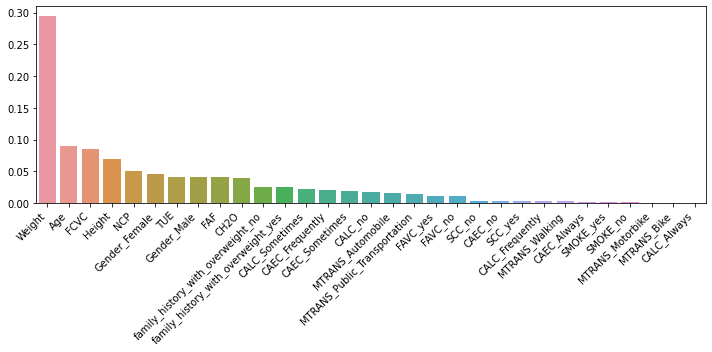


Top 10 Features:
Variable: Weight               Importance: 0.3
Variable: Age                  Importance: 0.09
Variable: FCVC                 Importance: 0.09
Variable: Height               Importance: 0.07
Variable: Gender_Female        Importance: 0.05
Variable: NCP                  Importance: 0.05
Variable: Gender_Male          Importance: 0.04
Variable: CH2O                 Importance: 0.04
Variable: FAF                  Importance: 0.04
Variable: TUE                  Importance: 0.04

Bottom 10 Features:
Variable: CAEC_Always          Importance: 0.0
Variable: CAEC_no              Importance: 0.0
Variable: SMOKE_no             Importance: 0.0
Variable: SMOKE_yes            Importance: 0.0
Variable: SCC_no               Importance: 0.0
Variable: SCC_yes              Importance: 0.0
Variable: CALC_Always          Importance: 0.0
Variable: CALC_Frequently      Importance: 0.0
Variable: MTRANS_Bike          Importance: 0.0
Variable: MTRANS_Motorbike     Importance: 0.0


In [54]:
feature_imp = pd.Series(clf.feature_importances_, index=X.columns).sort_values(ascending=False)
fig = plt.figure(figsize=(10, 5))

# Creating a bar plot
sns.barplot(x=feature_imp.index, y=feature_imp)

# Add labels to your graph
plt.xticks(rotation=45, horizontalalignment='right')

plt.tight_layout()
plt.show()

# create features list
features_list = X.columns
features_list = features_list.tolist()

# Get numerical feature importances
importances = list(clf.feature_importances_)
# List of tuples with variable and importance
feature_importances = [(feature, round(importance, 2)) for feature, importance in zip(features_list, importances)]

# Sort the feature importances by most important first
feature_importances = sorted(feature_importances, key = lambda x: x[1], reverse = True)
# Print out the feature and importances 
print("\nTop 10 Features:")
display_top = [print('Variable: {:20} Importance: {}'.format(*pair)) for pair in feature_importances[:10]]

# Sort the feature importances by least important first
feature_importances = sorted(feature_importances, key = lambda x: x[1], reverse = False)
# Print out the feature and importances 
print("\nBottom 10 Features:")
display_bottom = [print('Variable: {:20} Importance: {}'.format(*pair)) for pair in feature_importances[:10]]

In [57]:
fi = pd.DataFrame(feature_importances)
fi

,0,1
0,CAEC_Always,0.00
1,CAEC_no,0.00
2,SMOKE_no,0.00
3,SMOKE_yes,0.00
4,SCC_no,0.00
5,SCC_yes,0.00
6,CALC_Always,0.00
7,CALC_Frequently,0.00
8,MTRANS_Bike,0.00
9,MTRANS_Motorbike,0.00


In [64]:
fi.to_csv('/Users/bryton/Desktop/ObesityDataSet/Important_Features.csv')

### Clustering

An experiment was made to use dataset's features clustering. Forming separate clusters would indicate that values for the given features are specific for particular overweight/obesity type. The task is performed with "KMeans" - the simplest clustering algorithm. Instantiating requires setting the number of clusters to form, as well as the number of centroids to generate. Number of clusters is known: 7, for each weight type. "K-means++" is the chosen method for initialization - it selects initial cluster centers in a smart way to speed up convergence.

In [93]:
scaler = StandardScaler()
X_scaled = scaler.fit(X).transform(X)
X_scaled = pd.DataFrame(X_scaled, columns=X.columns, index=X.index)
print(X_scaled.head())

   Gender_Female  Gender_Male  family_history_with_overweight_no  \
0       1.011914    -1.011914                          -0.472291   
1       1.011914    -1.011914                          -0.472291   
2      -0.988227     0.988227                          -0.472291   
3      -0.988227     0.988227                           2.117337   
4      -0.988227     0.988227                           2.117337   

   family_history_with_overweight_yes   FAVC_no  FAVC_yes  CAEC_Always  \
0                            0.472291  2.759769 -2.759769    -0.160478   
1                            0.472291  2.759769 -2.759769    -0.160478   
2                            0.472291  2.759769 -2.759769    -0.160478   
3                           -2.117337  2.759769 -2.759769    -0.160478   
4                           -2.117337  2.759769 -2.759769    -0.160478   

   CAEC_Frequently  CAEC_Sometimes   CAEC_no  ...  \
0        -0.359835        0.442757 -0.157344  ...   
1        -0.359835        0.442757 -0.15

In [96]:
# transform categorical variables into dummie variables
dummies1 = pd.DataFrame(pd.get_dummies(df))

dummies1

,Age,Height,Weight,FCVC,NCP,CH2O,FAF,TUE,Gender_Female,Gender_Male,...,MTRANS_Motorbike,MTRANS_Public_Transportation,MTRANS_Walking,NObeyesdad_Insufficient_Weight,NObeyesdad_Normal_Weight,NObeyesdad_Obesity_Type_I,NObeyesdad_Obesity_Type_II,NObeyesdad_Obesity_Type_III,NObeyesdad_Overweight_Level_I,NObeyesdad_Overweight_Level_II
0,21.000000,1.620000,64.000000,2.0,3.0,2.000000,0.000000,1.000000,1,0,...,0,1,0,0,1,0,0,0,0,0
1,21.000000,1.520000,56.000000,3.0,3.0,3.000000,3.000000,0.000000,1,0,...,0,1,0,0,1,0,0,0,0,0
2,23.000000,1.800000,77.000000,2.0,3.0,2.000000,2.000000,1.000000,0,1,...,0,1,0,0,1,0,0,0,0,0
3,27.000000,1.800000,87.000000,3.0,3.0,2.000000,2.000000,0.000000,0,1,...,0,0,1,0,0,0,0,0,1,0
4,22.000000,1.780000,89.800000,2.0,1.0,2.000000,0.000000,0.000000,0,1,...,0,1,0,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2106,20.976842,1.710730,131.408528,3.0,3.0,1.728139,1.676269,0.906247,1,0,...,0,1,0,0,0,0,0,1,0,0
2107,21.982942,1.748584,133.742943,3.0,3.0,2.005130,1.341390,0.599270,1,0,...,0,1,0,0,0,0,0,1,0,0
2108,22.524036,1.752206,133.689352,3.0,3.0,2.054193,1.414209,0.646288,1,0,...,0,1,0,0,0,0,0,1,0,0
2109,24.361936,1.739450,133.346641,3.0,3.0,2.852339,1.139107,0.586035,1,0,...,0,1,0,0,0,0,0,1,0,0


In [98]:
scaler = StandardScaler()
d_scaled = scaler.fit(dummies1).transform(dummies1)
d_scaled = pd.DataFrame(d_scaled, columns=dummies1.columns, index=dummies1.index)
print(d_scaled.head())

        Age    Height    Weight      FCVC       NCP      CH2O       FAF  \
0 -0.522124 -0.875589 -0.862558 -0.785019  0.404153 -0.013073 -1.188039   
1 -0.522124 -1.947599 -1.168077  1.088342  0.404153  1.618759  2.339750   
2 -0.206889  1.054029 -0.366090 -0.785019  0.404153 -0.013073  1.163820   
3  0.423582  1.054029  0.015808  1.088342  0.404153 -0.013073  1.163820   
4 -0.364507  0.839627  0.122740 -0.785019 -2.167023 -0.013073 -1.188039   

        TUE  Gender_Female  Gender_Male  ...  MTRANS_Motorbike  \
0  0.561997       1.011914    -1.011914  ...         -0.072375   
1 -1.080625       1.011914    -1.011914  ...         -0.072375   
2  0.561997      -0.988227     0.988227  ...         -0.072375   
3 -1.080625      -0.988227     0.988227  ...         -0.072375   
4 -1.080625      -0.988227     0.988227  ...         -0.072375   

   MTRANS_Public_Transportation  MTRANS_Walking  \
0                      0.579721       -0.165078   
1                      0.579721       -0.165078   

In [66]:
from sklearn.cluster import KMeans

In [99]:
k = KMeans(n_clusters = 7, init = 'k-means++', random_state = 0).fit(d_scaled)

<AxesSubplot:xlabel='Height', ylabel='Weight'>

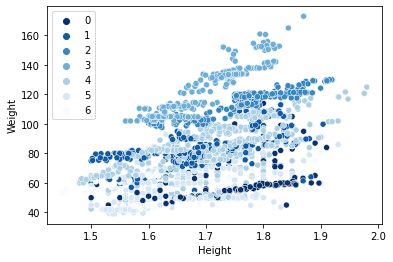

In [103]:
sns.scatterplot(data = df, x = df['Height'], y = df['Weight'], hue = k.labels_, palette = 'Blues_r')

<AxesSubplot:xlabel='Age', ylabel='Weight'>

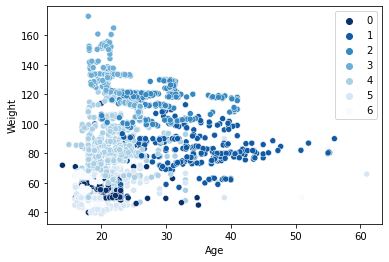

In [106]:
sns.scatterplot(data = df, x = df['Age'], y = df['Weight'], hue = k.labels_, palette = 'Blues_r')

<AxesSubplot:xlabel='Age', ylabel='Height'>

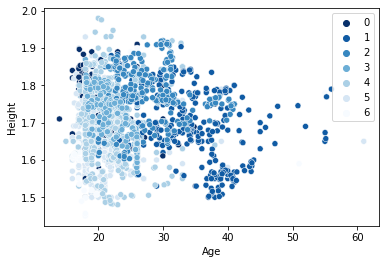

In [107]:
sns.scatterplot(data = df, x = df['Age'], y = df['Height'], hue = k.labels_, palette = 'Blues_r')